In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
data_path = './data/combined_data.csv'

## 读入数据

In [3]:
raw_data = pd.read_csv(data_path)
raw_data.head()

,WindNumber,Time,WindSpeed,Power,RotorSpeed,Width,RatedPower,CutInWindSpeed,CutOutWindSpeed,WheelSpeedMin,WheelSpesdMax
0,1,2017/11/1 0:20,4.188333,65.750000,5.779167,99.0,2000,3.0,25,8.33,16.8
1,1,2017/11/1 0:30,4.042500,120.700000,8.636500,99.0,2000,3.0,25,8.33,16.8
2,1,2017/11/1 0:40,4.137368,135.157895,8.668421,99.0,2000,3.0,25,8.33,16.8
3,1,2017/11/1 0:50,4.274737,157.315789,8.727895,99.0,2000,3.0,25,8.33,16.8
4,1,2017/11/1 1:00,4.108947,129.894737,8.656842,99.0,2000,3.0,25,8.33,16.8


In [5]:
raw_data['label']=0

### 设置待处理的部分数据

**！修改这里切换数据集！**

In [6]:
current_rotor = 7
current_data = raw_data[raw_data['WindNumber']==current_rotor]

In [7]:
current_data.shape

(43324, 12)

### 获得年月日的特征

In [8]:
# 获得年月日的特征
current_data['Year'] = current_data['Time'].apply(lambda x:int(x.split(' ')[0].split('/')[0]))
current_data['Month'] = current_data['Time'].apply(lambda x:int(x.split(' ')[0].split('/')[1]))
current_data['Day'] = current_data['Time'].apply(lambda x:int(x.split(' ')[0].split('/')[2]))
current_data.head()

,WindNumber,Time,WindSpeed,Power,RotorSpeed,Width,RatedPower,CutInWindSpeed,CutOutWindSpeed,WheelSpeedMin,WheelSpesdMax,label,Year,Month,Day
259466,7,2017/11/1 0:10,6.537000,290.500000,9.765000,99.0,2000,3.0,25,8.33,16.8,0,2017,11,1
259467,7,2017/11/1 0:20,6.920500,371.700000,10.358500,99.0,2000,3.0,25,8.33,16.8,0,2017,11,1
259468,7,2017/11/1 0:30,6.434000,309.650000,9.892500,99.0,2000,3.0,25,8.33,16.8,0,2017,11,1
259469,7,2017/11/1 0:40,5.262222,193.000000,8.907222,99.0,2000,3.0,25,8.33,16.8,0,2017,11,1
259470,7,2017/11/1 0:50,4.924444,180.722222,8.838889,99.0,2000,3.0,25,8.33,16.8,0,2017,11,1


In [9]:
set(current_data['Month'].values)

{1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12}

### 查看数据分布

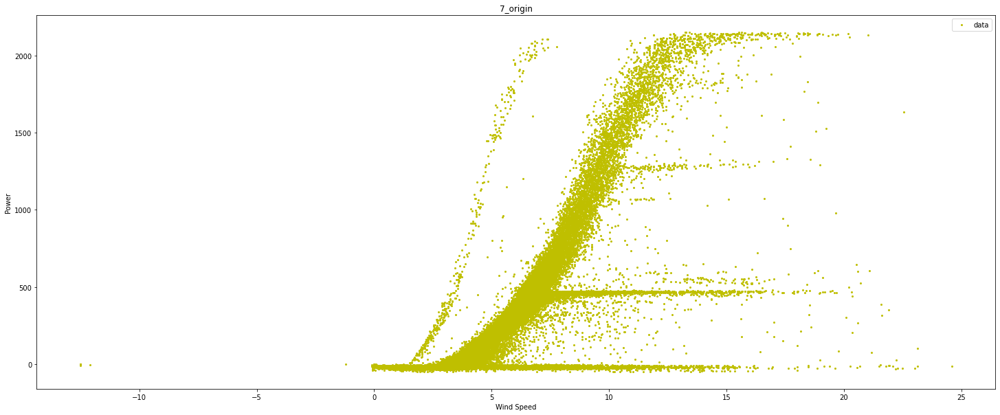

In [11]:
plt.figure(figsize=(25, 10))
g_data_2 = current_data[current_data['label'] == 0]
plt.plot(g_data_2['WindSpeed'],
            g_data_2['Power'],
            '.y',
            ms=4,
            label='data')
plt.legend()
plt.xlabel('Wind Speed')
plt.ylabel('Power')
cur_title = "{}_origin".format(current_rotor)
plt.title(cur_title)
plt.show()

### 查看四个季节的数据

In [12]:
season_data = current_data.groupby('Month')
# season_data.groups
spring_data = pd.concat([season_data.get_group(1), season_data.get_group(2), season_data.get_group(3)])
summer_data = pd.concat([season_data.get_group(4), season_data.get_group(5), season_data.get_group(6)])
autumn_data = pd.concat([season_data.get_group(7), season_data.get_group(8), season_data.get_group(9)])
winter_data = pd.concat([season_data.get_group(10), season_data.get_group(11), season_data.get_group(12)])

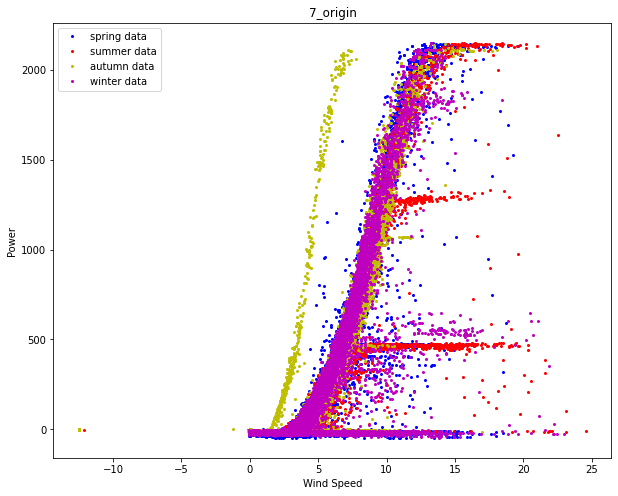

In [13]:
plt.figure(figsize=(10,8))
g_data_2 = spring_data
plt.plot(g_data_2['WindSpeed'],
            g_data_2['Power'],
            '.b',
            ms=4,
            label='spring data')
g_data_2 = summer_data
plt.plot(g_data_2['WindSpeed'],
            g_data_2['Power'],
            '.r',
            ms=4,
            label='summer data')
g_data_2 = autumn_data
plt.plot(g_data_2['WindSpeed'],
            g_data_2['Power'],
            '.y',
            ms=4,
            label='autumn data')
g_data_2 = winter_data
plt.plot(g_data_2['WindSpeed'],
            g_data_2['Power'],
            '.m',
            ms=4,
            label='winter data')
plt.legend()
plt.xlabel('Wind Speed')
plt.ylabel('Power')
cur_title = "{}_origin".format(current_rotor)
plt.title(cur_title)
plt.show()

### 查看月份数据

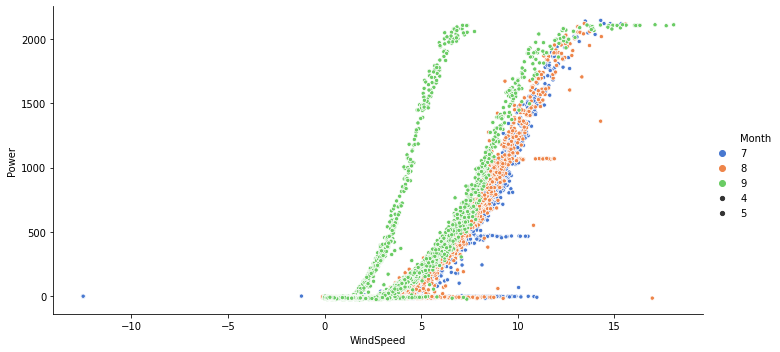

In [14]:
sns.relplot(x='WindSpeed', y='Power', hue='Month', data=current_data[(current_data['Month']==7) | (current_data['Month']==8) | (current_data['Month']==9)] , palette='muted', size=5, aspect=2)

In [15]:
line_high_data = pd.concat([season_data.get_group(x) for x in [9]])
line_low_data = pd.concat([season_data.get_group(x) for x in [1,2,3,4,5,6,7,8,10,11,12]])

- line high data

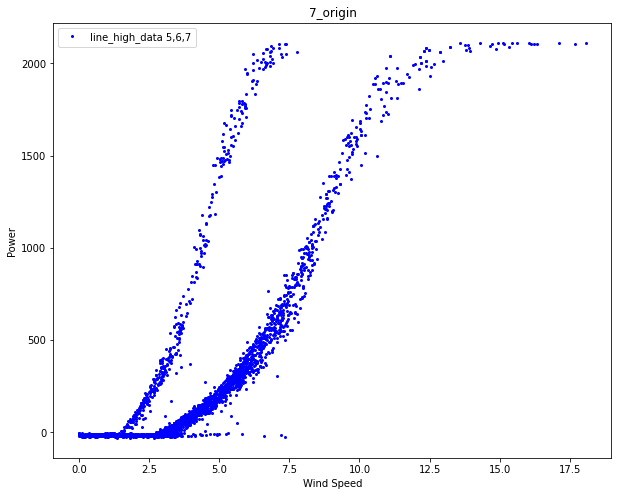

In [16]:
plt.figure(figsize=(10,8))
g_data = line_high_data
plt.plot(g_data['WindSpeed'],
            g_data['Power'],
            '.b',
            ms=4,
            label='line_high_data 5,6,7')
plt.legend()
plt.xlabel('Wind Speed')
plt.ylabel('Power')
cur_title = "{}_origin".format(current_rotor)
plt.title(cur_title)
plt.show()

- line low data

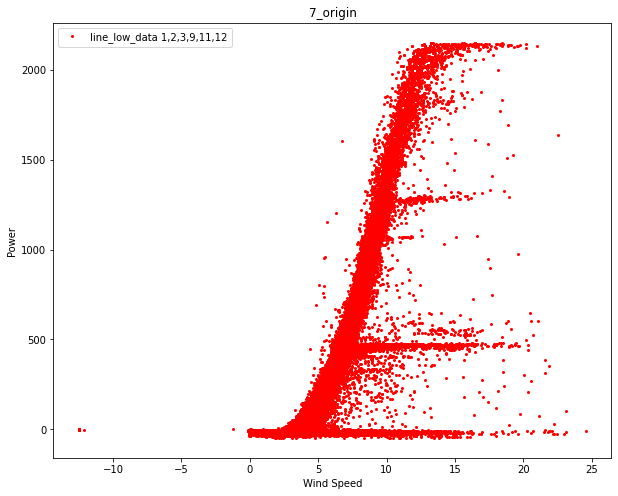

In [17]:
plt.figure(figsize=(10,8))
g_data = line_low_data
plt.plot(g_data['WindSpeed'],
            g_data['Power'],
            '.r',
            ms=4,
            label='line_low_data 1,2,3,9,11,12')
plt.legend()
plt.xlabel('Wind Speed')
plt.ylabel('Power')
cur_title = "{}_origin".format(current_rotor)
plt.title(cur_title)
plt.show()

### 七号风机两条曲线数据

1. 左边曲线
    - 9月10-17号
2. 右边曲线
    - 除了9月，加上0月1-9号，>=18号

### 查看九月数据

- 左边
    - 10-17号
- 右边
    - 1-9号，>=18号

In [18]:
Sep_data = current_data[current_data['Month']==9]

- 1-9号

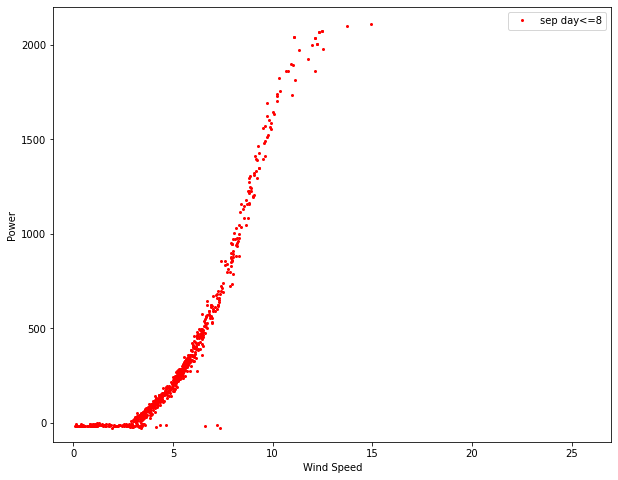

In [31]:
plt.figure(figsize=(10,8))
g_data = Sep_data[(Sep_data['Day']<=9)]
plt.plot(g_data['WindSpeed'],
            g_data['Power'],
            '.r',
            ms=4,
            label='sep day<=9')
plt.legend()
plt.xlabel('Wind Speed')
plt.ylabel('Power')
plt.ylim((-100,2200))
plt.xlim((-1,27))
plt.show()

- 10-17号

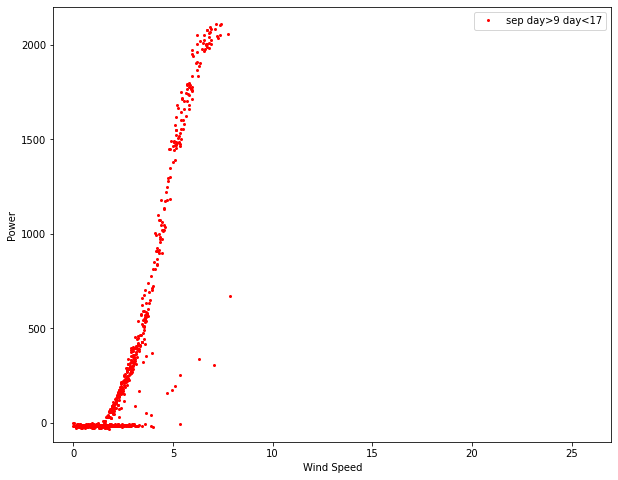

In [47]:
plt.figure(figsize=(10,8))
g_data = Sep_data[((Sep_data['Day']>9) & (Sep_data['Day']<=17))]
plt.plot(g_data['WindSpeed'],
            g_data['Power'],
            '.r',
            ms=4,
            label='sep day>9 day<=17')
plt.legend()
plt.xlabel('Wind Speed')
plt.ylabel('Power')
plt.ylim((-100,2200))
plt.xlim((-1,27))
plt.show()

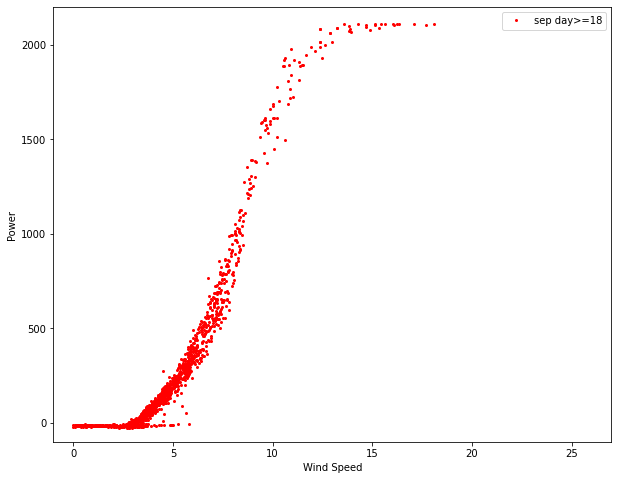

In [52]:
plt.figure(figsize=(10,8))
g_data = Sep_data[((Sep_data['Day']>=18) )]
plt.plot(g_data['WindSpeed'],
            g_data['Power'],
            '.r',
            ms=4,
            label='sep day>=18')
plt.legend()
plt.xlabel('Wind Speed')
plt.ylabel('Power')
plt.ylim((-100,2200))
plt.xlim((-1,27))
plt.show()